In [12]:
#from shapely.geometry import Point
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster

#### Let's load the Nashville zipcode data and look at the first few rows
- geopandas reads files with the `read_file()` method
- The zipcode data was downloaded from https://data.nashville.gov/General-Government/Zip-Codes/u7r5-bpku


In [13]:
zipcodes = gpd.read_file('../data/zipcodes.geojson')
print(zipcodes.crs)
zipcodes.head( )

EPSG:4326


,zip,objectid,po_name,shape_stlength,shape_starea,geometry
0,37115,1,MADISON,178783.02488886821,596553400.57885742,"MULTIPOLYGON (((-86.68725 36.31821, -86.68722 ..."
1,37216,3,NASHVILLE,75820.997821400058,188884682.28344727,"MULTIPOLYGON (((-86.73451 36.23774, -86.73425 ..."
2,37204,9,NASHVILLE,93180.292250425613,200664795.51708984,"MULTIPOLYGON (((-86.77914 36.13424, -86.77923 ..."
3,37027,11,BRENTWOOD,159760.6942933173,174978422.04101562,"MULTIPOLYGON (((-86.81258 36.06319, -86.81263 ..."
4,37064,18,FRANKLIN,28995.828320601937,46969608.005737305,"MULTIPOLYGON (((-87.02197 36.01200, -87.02140 ..."


In [14]:
service_request = gpd.read_file('../data/hubNashville_311_Service_Requests_Current_Year_view.geojson')
print(service_request)
service_request.head()

        OBJECTID                              GlobalID  Status  \
0              1  ec8abd13-3f6d-49aa-8de8-73ffc69fa7d7  Closed   
1              2  1b8723e2-373d-452c-85b0-06c3ec9e7bad  Closed   
2              3  c24394d8-f588-4e40-aa87-bd3a8c8e8cfc  Closed   
3              4  c08b89d1-38b3-42d5-be39-afaaa1741cd8  Closed   
4              5  a5373ce6-72e0-4952-87a8-800a8cc5ac72  Closed   
...          ...                                   ...     ...   
186649    186650  69cb2062-5354-4997-9906-5a231425b679  Closed   
186650    186651  685293c5-5161-45a9-a46d-c5a0b21666ce  Closed   
186651    186652  23134dc4-70dc-4e0b-9aca-2649dc48be54  Closed   
186652    186653  985f6b62-2762-4266-9f88-fc39ff0035b2  Closed   
186653    186654  e472b5b1-f023-409a-8a3c-4e318070686b  Closed   

                                   Request_Type  \
0       Request Non-Emergency Police Assistance   
1                                  Water Outage   
2        Resolved by hubNashville on First Call   
3  

,OBJECTID,GlobalID,Status,Request_Type,Subrequest_Type,Additional_Subrequest_Type,Request_Origin,System_of_Origin_ID,Contact_Type,Preferred_Language,...,Longitude,Date_Time_Opened,Date_Time_Closed,ZIP,CreationDate,Creator,EditDate,Editor,Request__,geometry
0,1,ec8abd13-3f6d-49aa-8de8-73ffc69fa7d7,Closed,Request Non-Emergency Police Assistance,Request Non-Emergency Police Assistance,None,Phone,None,None,None,...,-76.919515,"Wed, 03 Jan 2024 01:20:19 GMT","Wed, 03 Jan 2024 01:23:42 GMT",None,"Wed, 03 Jan 2024 14:09:25 GMT",hubNashville,"Thu, 04 Jan 2024 14:11:29 GMT",hubNashville,1440173,POINT Z (-76.91952 40.26306 0.00000)
1,2,1b8723e2-373d-452c-85b0-06c3ec9e7bad,Closed,Water Outage,Water Outage,Water Outage,Phone,None,None,None,...,-86.610455,"Tue, 02 Jan 2024 23:07:53 GMT","Wed, 03 Jan 2024 21:54:13 GMT",37217,"Wed, 03 Jan 2024 14:09:25 GMT",hubNashville,"Thu, 04 Jan 2024 14:11:29 GMT",hubNashville,1439937,POINT Z (-86.61045 36.09326 0.00000)
2,3,c24394d8-f588-4e40-aa87-bd3a8c8e8cfc,Closed,Resolved by hubNashville on First Call,Resolved by hubNashville on First Call,Resolved by hubNashville on First Call,Phone,None,None,None,...,NaN,"Tue, 02 Jan 2024 22:08:04 GMT","Tue, 02 Jan 2024 22:08:04 GMT",None,"Wed, 03 Jan 2024 14:09:25 GMT",hubNashville,"Thu, 04 Jan 2024 14:11:29 GMT",hubNashville,1439831,None
3,4,c08b89d1-38b3-42d5-be39-afaaa1741cd8,Closed,Shared Scooter and Bike Issues,Shared Scooter and Bike Issues,Scooter Complaint,Mobile App,None,None,None,...,-86.778858,"Wed, 03 Jan 2024 01:19:12 GMT","Wed, 03 Jan 2024 02:01:26 GMT",37203,"Wed, 03 Jan 2024 14:09:37 GMT",hubNashville,"Thu, 04 Jan 2024 14:11:29 GMT",hubNashville,1440170,POINT Z (-86.77886 36.13655 0.00000)
4,5,a5373ce6-72e0-4952-87a8-800a8cc5ac72,Closed,Repossessed Vehicle,Repossessed Vehicle,Repossessed Vehicle,hubNashville Community,None,None,None,...,NaN,"Tue, 02 Jan 2024 23:52:53 GMT","Tue, 02 Jan 2024 23:52:53 GMT",None,"Wed, 03 Jan 2024 14:09:37 GMT",hubNashville,"Thu, 04 Jan 2024 14:11:30 GMT",hubNashville,1440023,None


<Axes: >

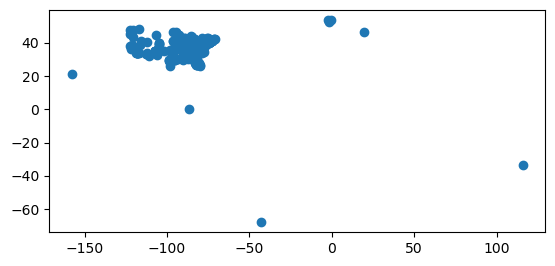

In [15]:
service_request.plot()

In [16]:
request_zip = gpd.sjoin(service_request, zipcodes, predicate = 'within')

In [17]:
request_zip.head()

,OBJECTID,GlobalID,Status,Request_Type,Subrequest_Type,Additional_Subrequest_Type,Request_Origin,System_of_Origin_ID,Contact_Type,Preferred_Language,...,EditDate,Editor,Request__,geometry,index_right,zip,objectid,po_name,shape_stlength,shape_starea
1,2,1b8723e2-373d-452c-85b0-06c3ec9e7bad,Closed,Water Outage,Water Outage,Water Outage,Phone,None,None,None,...,"Thu, 04 Jan 2024 14:11:29 GMT",hubNashville,1439937,POINT Z (-86.61045 36.09326 0.00000),17,37217,56,NASHVILLE,179866.56847992647,517579208.08972168
3,4,c08b89d1-38b3-42d5-be39-afaaa1741cd8,Closed,Shared Scooter and Bike Issues,Shared Scooter and Bike Issues,Scooter Complaint,Mobile App,None,None,None,...,"Thu, 04 Jan 2024 14:11:29 GMT",hubNashville,1440170,POINT Z (-86.77886 36.13655 0.00000),35,37203,33,NASHVILLE,91285.438580354588,120649702.5546875
5,6,cf54cb75-81fc-4c5c-8809-25466570ce6a,Closed,Dead Animal Pickup,Dead Animal Pickup,None,Phone,None,None,None,...,"Thu, 04 Jan 2024 14:11:30 GMT",hubNashville,1439844,POINT Z (-86.78460 36.07414 0.00000),53,37220,8,NASHVILLE,121112.34010755506,235801795.49957275
6,7,6aa94f83-05ac-43e9-84ee-624d221b88df,Closed,Missed Pickup - Recycle Cart Service,Missed Pickup - Recycle Cart Service,Recycle - Curbside/Alley Missed Pickup,Phone,None,None,None,...,"Thu, 04 Jan 2024 14:11:30 GMT",hubNashville,1439903,POINT Z (-86.81099 36.12247 0.00000),44,37215,38,NASHVILLE,158698.30754566603,424774478.15600586
7,8,82f28160-94b0-4d4c-bac7-10357c24f4fc,Closed,New Service / Activate Service,New Service/Activate Service,Activate your Trash Service Account,hubNashville Community,None,None,None,...,"Thu, 04 Jan 2024 14:11:30 GMT",hubNashville,1440087,POINT Z (-86.81225 36.13020 0.00000),9,37212,54,NASHVILLE,58759.243654332378,73920091.147705078


In [18]:
request_zip['zip'].value_counts()

zip
37013    13216
37211    12091
37207     9450
37209     9428
37203     8163
37206     7682
37115     6012
37208     5727
37214     5564
37217     5170
37210     4816
37216     4273
37205     3979
37215     3908
37076     3828
37204     3644
37212     3450
37218     3086
37201     3000
37221     2967
37138     1756
37219     1506
37027     1400
37072     1085
37220      950
37189      612
37080      522
37213      415
37228      218
37135      108
37122       72
37086       59
37232       55
37143       55
37015       54
37240       12
37064        7
Name: count, dtype: int64

In [48]:
request_zip_37207_37208 = request_zip.loc[request_zip['zip'].isin(['37207', '37208'])]
request_zip_37207_37208.shape

(15177, 33)

In [49]:
polygon37207_37208 = zipcodes.loc[zipcodes['zip'].isin(['37207', '37208'])]
polygon37207_37208.shape

(3, 6)

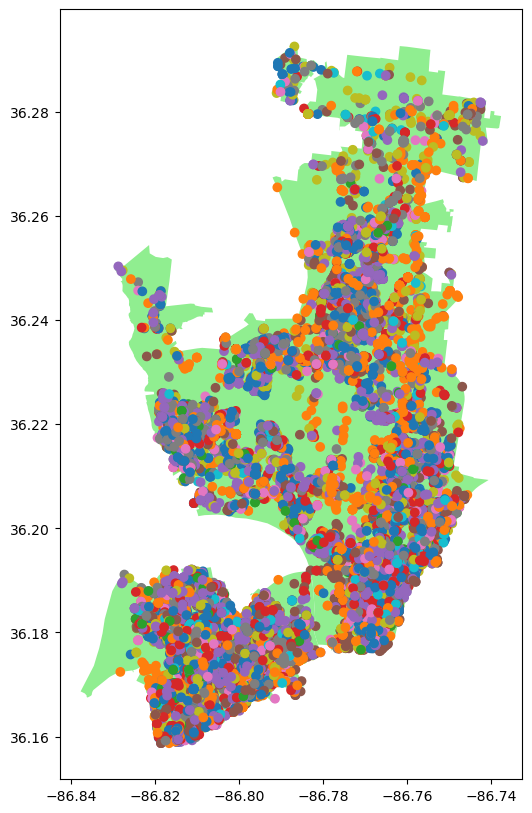

In [50]:
#fig, ax = matplotlib.subplots()
ax = polygon37207_37208.plot(figsize = (8, 10), color = 'lightgreen')
request_zip_37207_37208.plot( ax = ax, column = 'Request_Type');
plt.show();

In [51]:
polygon37207_37208.geometry.centroid

C:\Users\hayli\AppData\Local\Temp\ipykernel_21852\623749828.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  polygon37207_37208.geometry.centroid


19    POINT (-86.78726 36.28724)
40    POINT (-86.80805 36.17736)
42    POINT (-86.77677 36.23245)
dtype: geometry

In [52]:
#find the center of the larger (more southern) polygon and look at it
center = polygon37207_37208.geometry.centroid[42]
print(center)

POINT (-86.77676762469858 36.23245257407244)


C:\Users\hayli\AppData\Local\Temp\ipykernel_21852\3682035574.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  center = polygon37207_37208.geometry.centroid[42]


In [53]:
# reverse the order when constructing the array for folium location
area_center = [center.y, center.x]

# check the order of area_center, the location for our folium map
print(area_center)

[36.23245257407244, -86.77676762469858]


In [39]:
type(zipcodes)

geopandas.geodataframe.GeoDataFrame

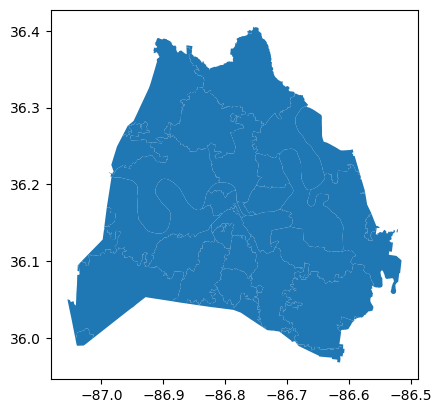

In [59]:
zipcodes.plot();

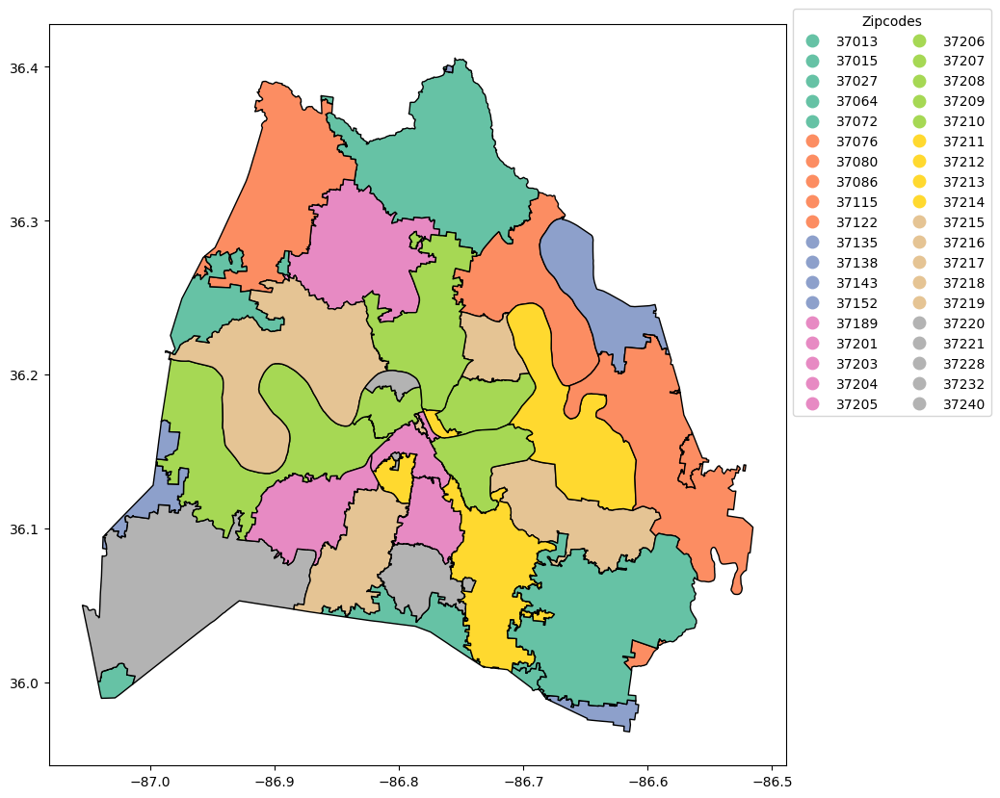

In [60]:
#geopandas will take care of legend styling if you pass a dict of keywords

leg_kwds = {'title': 'Zipcodes', 'loc': 'upper left', 
            'bbox_to_anchor': (1, 1.03), 'ncol': 2}

zipcodes.plot(column = 'zip', figsize=(10, 10),
              edgecolor = 'black',
              legend = True, legend_kwds = leg_kwds, 
              cmap = 'Set2')
plt.show()

In [54]:
#create our map of Nashville Zip Code 37207 and show it
map_37207 = folium.Map(location =  area_center, zoom_start = 12)
map_37207

In [65]:
cluster_map_37207_37208 = folium.Map(location =  area_center, zoom_start = 12)

#create a marker cluster
marker_cluster = MarkerCluster().add_to(cluster_map_37207_37208)

folium.GeoJson(polygon37207_37208).add_to(cluster_map_37207_37208)

# inside the loop add each marker to the cluster
for row_index, row_values in request_zip_37207_37208.iterrows():
    loc = [row_values['Latitude'], row_values['Longitude']]
    pop = str(row_values['Request_Type'])
    icon=folium.Icon(color="blue",icon="screwdriver-wrench", prefix='fa')
    
    marker = folium.Marker(
        location = loc, 
        popup = pop,
    icon = icon) 
    
    marker.add_to(marker_cluster)

    
#save an interactive HTML map by calling .save()
cluster_map_37207_37208.save('../maps/cluster37207.html')

cluster_map_37207_37208 